In [1]:
#import the essential libraries
import os
import cv2
import pydicom
import numpy as np
import matplotlib.pyplot as plt
from matplotlib import colors


In [ ]:
#function to load DICOM files from a directory 
def load_dicom_files(directory):
    dicom_files = [pydicom.dcmread(os.path.join(directory,f)) for f in os.listdir(directory)]
    return dicom_files


dicom_patient_dir = "/home/khanh/khanh/IMAGE_PROCESSING/3Dircadb1/3Dircadb1.1/PATIENT_DICOM"
dicom_label_dir = "/home/khanh/khanh/IMAGE_PROCESSING/3Dircadb1/3Dircadb1.1/LABELLED_DICOM"
dicom_mask_dir = "/home/khanh/khanh/IMAGE_PROCESSING/3Dircadb1/3Dircadb1.1/MASKS_DICOM/artery"

dicom_label = load_dicom_files(dicom_label_dir)
dicom_patient = load_dicom_files(dicom_patient_dir)
#dicom_mask = load_dicom_files(dicom_mask_dir)


print(len(dicom_patient))
print(len(dicom_label))
#print(len(dicom_mask))


In [3]:

#function to apply windowing
def apply_windowing(image,window_center,window_width):
    window_min = window_center - (window_width / 2)
    window_max = window_center + (window_width / 2)
    image = np.clip(image, window_min, window_max)

    return ((image - window_min) / (window_max - window_min) * 255).astype(np.uint8)

# Organ window settings
organ_window_settings = {
    'Liver': (50, 100),
    'Kidney': (40, 100),
    'Bone': (300, 1500),
}


In [5]:
def load_dicom_image(filepath):
    dicom_data = pydicom.dcmread(filepath)
    image = dicom_data.pixel_array
    return image

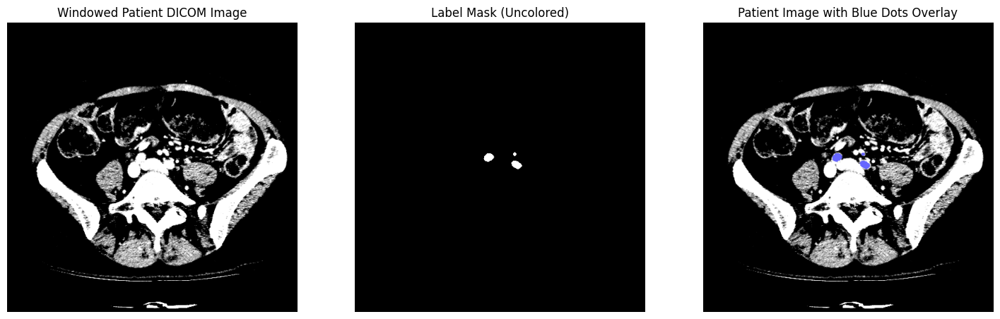

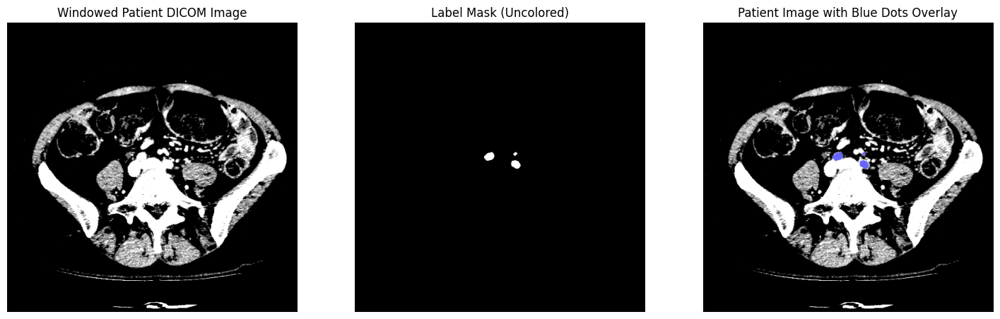

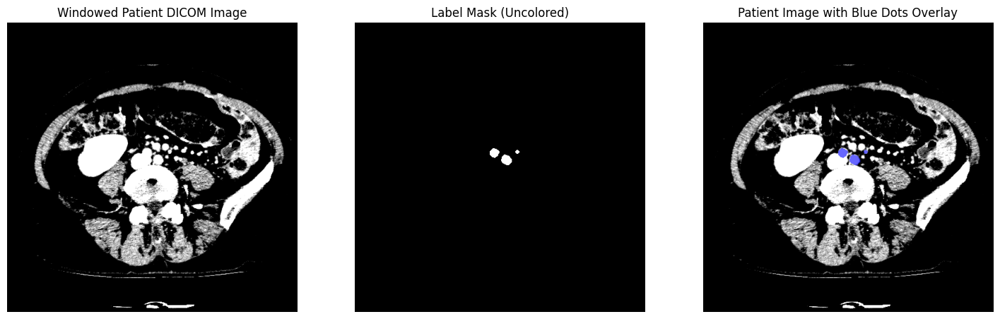

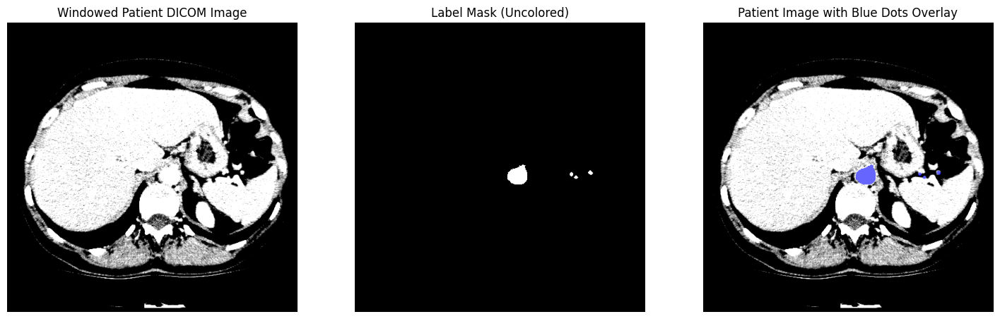

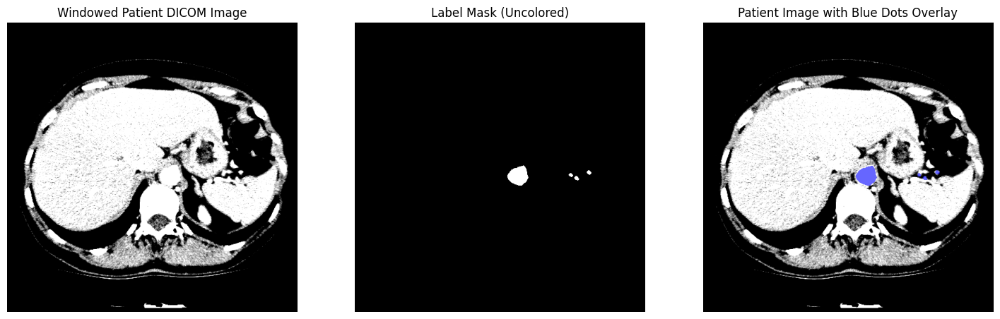

...

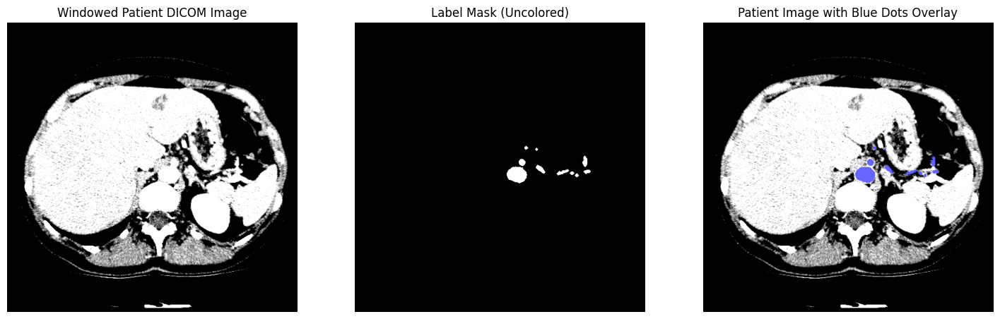

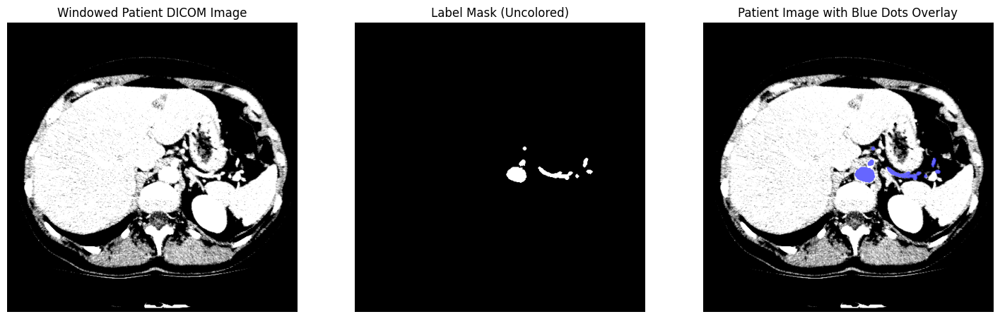

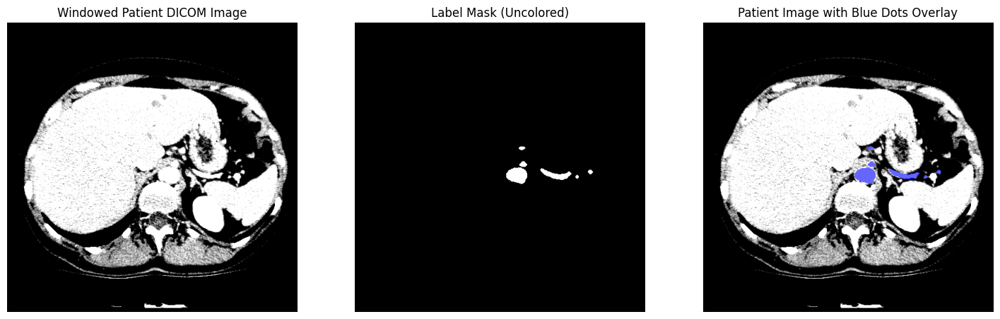

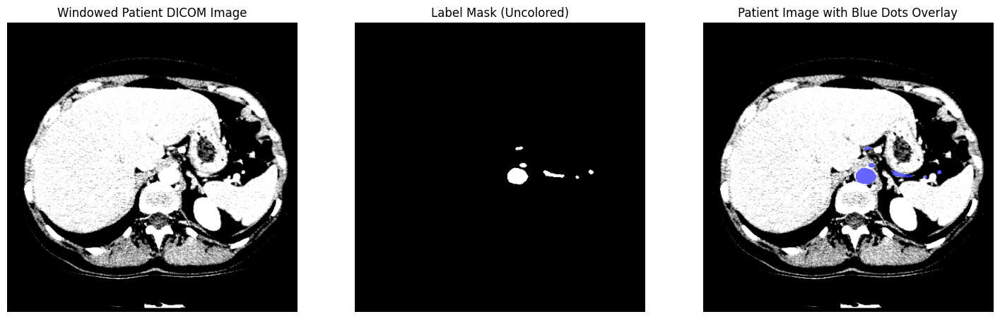

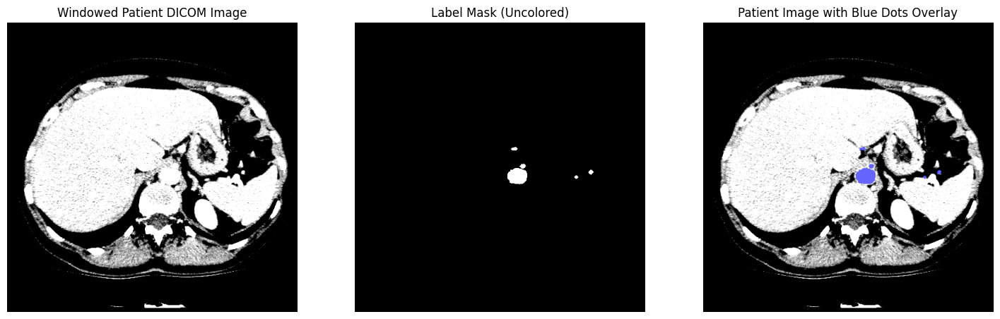

In [6]:
def apply_window_for_organ(dicom_image, organ):
    if organ in organ_window_settings:
        window_center, window_width = organ_window_settings[organ]
    else:
        raise ValueError(f"Unknown organ '{organ}'. Available options are: {list(organ_window_settings.keys())}")
    
    return apply_windowing(dicom_image.pixel_array, window_center, window_width)

# Function to extract white dots using thresholding
def extract_white_dots(image, threshold_value=200):
    _, thresholded_image = cv2.threshold(image, threshold_value, 255, cv2.THRESH_BINARY)
    kernel = np.ones((3, 3), np.uint8)
    cleaned_image = cv2.morphologyEx(thresholded_image, cv2.MORPH_OPEN, kernel)
    return cleaned_image

# Function to overlay white dots onto the windowed patient image in blue
def overlay_white_dots_on_image(base_image, dots_image):
    base_image_rgb = cv2.cvtColor(base_image, cv2.COLOR_GRAY2RGB)
    r, g, b = cv2.split(base_image_rgb)
    b[dots_image == 255] = 255  # Set blue channel to 255 where the dots are
    r[dots_image == 255] = 0    # Set red channel to 0 to prevent yellow
    g[dots_image == 255] = 0    # Set green channel to 0 to prevent yellow
    overlay_image = cv2.merge([r, g, b])
    return overlay_image

# Function to plot patient image, label mask, and colored mask overlay
def plot_patient_label_mask(patient_file, mask_file, organ):
    # Load the DICOM image for the patient
    dicom_image = pydicom.dcmread(patient_file)
    
    # Apply windowing to the patient image based on the specified organ
    patient_image = apply_window_for_organ(dicom_image, organ)
    
    # Load the DICOM label mask
    mask_image = load_dicom_image(mask_file)

    # Extract white dots from the mask image
    white_dots = extract_white_dots(mask_image, threshold_value=200)

    # Overlay the white dots onto the windowed patient image
    overlay_image = overlay_white_dots_on_image(patient_image, white_dots)

    # Create a figure with 3 subplots
    fig, axs = plt.subplots(1, 3, figsize=(18, 6))

    # Plot the patient DICOM image (grayscale)
    axs[0].imshow(patient_image, cmap='gray')
    axs[0].set_title('Windowed Patient DICOM Image')
    axs[0].axis('off')

    # Plot the label mask image (uncolored)
    axs[1].imshow(mask_image, cmap='gray')
    axs[1].set_title('Label Mask (Uncolored)')
    axs[1].axis('off')

    # Plot the patient image with blue dots overlay
    axs[2].imshow(patient_image, cmap='gray')  # Background patient image
    axs[2].imshow(overlay_image, alpha=0.6)  # Overlay the dots with transparency
    axs[2].set_title('Patient Image with Blue Dots Overlay')
    axs[2].axis('off')

    plt.show()

# Path to directories containing DICOM files
patient_dir = '/home/khanh/khanh/IMAGE_PROCESSING/3Dircadb1/3Dircadb1.1/PATIENT_DICOM'
masks_dir = '/home/khanh/khanh/IMAGE_PROCESSING/3Dircadb1/3Dircadb1.1/MASKS_DICOM/artery'

# Load the patient DICOM file
patient_files = sorted([os.path.join(patient_dir, f) for f in os.listdir(patient_dir)])
mask_files = sorted([os.path.join(masks_dir, f) for f in os.listdir(masks_dir)])

# Display the patient DICOM image, label mask, and color overlay
for patient_file, mask_file in zip(patient_files, mask_files):
    plot_patient_label_mask(patient_file, mask_file, 'Liver')